#Cloning Repository and Installing Requirements 

In [2]:
!git clone https://github.com/ultralytics/yolov5  
%cd yolov5
%pip install -qr requirements.txt  

Cloning into 'yolov5'...
remote: Enumerating objects: 10469, done.
remote: Total 10469 (delta 0), reused 0 (delta 0), pack-reused 10469
Receiving objects: 100% (10469/10469), 10.67 MiB | 23.71 MiB/s, done.
Resolving deltas: 100% (7229/7229), done.
/content/yolov5
     |████████████████████████████████| 596 kB 5.1 MB/s 


Importing Libraries

In [3]:
import torch
import cv2
import numpy as np
from matplotlib import pyplot as plt
from yolov5 import utils
display = utils.notebook_init() 

YOLOv5 🚀 v6.0-181-gf80c463 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 42.0/78.2 GB disk)


Importing Weights and Creating Model

In [4]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

Downloading: "https://github.com/ultralytics/yolov5/archive/master.zip" to /root/.cache/torch/hub/master.zip


requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...

requirements: 1 package updated per /content/yolov5/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



YOLOv5 🚀 v6.0-181-gf80c463 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)



  0%|          | 0.00/14.0M [00:00<?, ?B/s]

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


In [5]:
#To see the model layers

#model

In [6]:
#creating an img link
img = 'https://www.carscoops.com/wp-content/uploads/2020/09/Human-Horizons-HiPhi-X-1a-1024x555.jpg'

In [ ]:
#Using model to predict things in the img
results = model(img)
results.print()

image 1/1: 555x1024 5 persons, 1 truck
Speed: 220.3ms pre-process, 30.2ms inference, 46.7ms NMS per image at shape (1, 3, 352, 640)


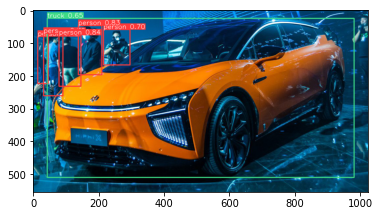

In [ ]:
#printing img
%matplotlib inline
plt.imshow(np.squeeze(results.render())) 

In [20]:
#Install Pytube so that we dont need to connect with a drive to upload videos
! pip install pytube


     |████████████████████████████████| 56 kB 2.4 MB/s 


In [21]:
#Import libraries and download the video
from pytube import YouTube
yt = YouTube('https://www.youtube.com/watch?v=vfQZ0OSXpHg&ab_channel=AutopiaSingapore')
yt.streams.filter(res="360p", progressive=True).order_by('resolution').desc().first().download(filename='video.mp4')

'/content/yolov5/video.mp4'

In [ ]:
#If you want to upload from drive uncomment next 2 lines


#from google.colab import files
#uploaded = files.upload()

Code to first write a video and then watch it

In [ ]:
import cv2
import numpy as np

# Create a VideoCapture object
cap = cv2.VideoCapture('video.mp4')

# Check if video opened successfully
if (cap.isOpened() == False): 
  print("Unable to read from video")

# Default resolutions of the frame are obtained.The default resolutions are system dependent.
# We convert the resolutions from float to integer.
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))

# Define the codec and create VideoWriter object.The output is stored in 'out_vid.avi/mp4' file.
out = cv2.VideoWriter('out_vid.mp4',cv2.VideoWriter_fourcc('M','J','P','G'), 30, (frame_width,frame_height))

while(True):
  ret, frame = cap.read()

  if ret == True: 
    
    # Apply model to each frame and pass the results into the file 'out_vid.avi/mp4'
    results = model(frame)
    out.write(np.squeeze(results.render()))

    # Press Q on keyboard to stop recording
    if cv2.waitKey(1) & 0xFF == ord('q'):
      break

  # Break the loop
  else:
    break  

# When everything done, release the video capture and video write objects
cap.release()
out.release()

# Closes all the frames
cv2.destroyAllWindows()

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "/content/yolov5/out_vid.mp4"

# Compressed video path
compressed_path = "/content/yolov5/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

# Transfer Learning using yolov5 with custom dataset
## Traffic signs dataset taken from kaggle

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

from google.colab import files
files.upload()  #this will prompt you to upload the kaggle.json

!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!ls ~/.kaggle
!chmod 600 /root/.kaggle/kaggle.json  # set permission

!kaggle datasets download -d valentynsichkar/traffic-signs-dataset-in-yolo-format

! mkdir traffic_signs
! unzip traffic-signs-dataset-in-yolo-format.zip -d traffic_signs


In [8]:
#Installing these libraries to split into train and validation set

! pip install split-folders
! pip install split-folders tqdm

making, moving and splitting data

In [9]:
! mkdir traffic_signs/ts/ts/images
! mkdir traffic_signs/ts/ts/labels

In [10]:
!mv traffic_signs/ts/ts/*.txt traffic_signs/ts/ts/labels
!mv traffic_signs/ts/ts/*.jpg traffic_signs/ts/ts/images


In [11]:
import splitfolders
splitfolders.ratio("traffic_signs/ts/ts", output="output", seed=1337, ratio=(.8, .2), group_prefix=1) 

Copying files: 1482 files [00:02, 692.09 files/s]


Upload dataset.yaml file from drive or local hardisk

In [12]:
from google.colab import files
files.upload()  #this will prompt you to upload the kaggle.json

Saving dataset.yaml to dataset.yaml


{'dataset.yaml': b'path: output\ntrain: train/images\nval: val/images  \n\n\n# Classes\nnc: 4  \nnames: [prohibitory, danger, mandatory, other ]  \n'}

Training yolov5 on new dataset with 100 epochs. 

In [13]:
! python train.py --img 416 --batch 128 --epochs 100 --data dataset.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=, data=dataset.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=100, batch_size=64, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.0-181-gf80c463 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.1, scale=0.

Loading new model as model 2 and using it predict traffic signs with the same method as above

In [14]:
model2 = torch.hub.load('ultralytics/yolov5', 'custom', path = '/content/yolov5/runs/train/exp/weights/best.pt', force_reload = True)

Downloading: "https://github.com/ultralytics/yolov5/archive/master.zip" to /root/.cache/torch/hub/master.zip


requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...


YOLOv5 🚀 v6.0-181-gf80c463 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)




requirements: 1 package updated per /content/yolov5/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



Fusing layers... 
Model Summary: 213 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


image 1/1: 800x1360 1 prohibitory
Speed: 58.3ms pre-process, 25.5ms inference, 4.3ms NMS per image at shape (1, 3, 384, 640)


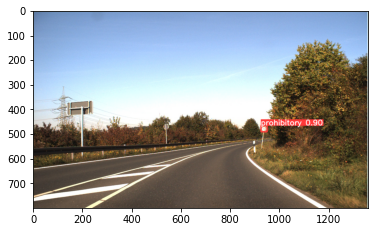

In [15]:
img = '/content/yolov5/traffic_signs/ts/ts/images/00009.jpg'
#Using model to predict things in the img
results = model2(img)
results.print()
#printing img
%matplotlib inline
plt.imshow(np.squeeze(results.render())) 

In [16]:
import cv2
import numpy as np

# Create a VideoCapture object
cap = cv2.VideoCapture('/content/yolov5/traffic_signs/traffic-sign-to-test.mp4')

# Check if video opened successfully
if (cap.isOpened() == False): 
  print("Unable to read from video")

# Default resolutions of the frame are obtained.The default resolutions are system dependent.
# We convert the resolutions from float to integer.
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))

# Define the codec and create VideoWriter object.The output is stored in 'out_vid.avi/mp4' file.
out = cv2.VideoWriter('out_vid_sign.mp4',cv2.VideoWriter_fourcc('M','J','P','G'), 30, (frame_width,frame_height))

while(True):
  ret, frame = cap.read()

  if ret == True: 
    
    # Apply model to each frame and pass the results into the file 'out_vid.avi/mp4'
    results = model2(frame)
    out.write(np.squeeze(results.render()))

    # Press Q on keyboard to stop recording
    if cv2.waitKey(1) & 0xFF == ord('q'):
      break

  # Break the loop
  else:
    break  

# When everything done, release the video capture and video write objects
cap.release()
out.release()

# Closes all the frames
cv2.destroyAllWindows()

In [17]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "/content/yolov5/out_vid_sign.mp4"

# Compressed video path
compressed_path = "/content/yolov5/result_compressed_sign.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

Checking another video

In [22]:
import cv2
import numpy as np

# Create a VideoCapture object
cap = cv2.VideoCapture('video.mp4')

# Check if video opened successfully
if (cap.isOpened() == False): 
  print("Unable to read from video")

# Default resolutions of the frame are obtained.The default resolutions are system dependent.
# We convert the resolutions from float to integer.
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))

# Define the codec and create VideoWriter object.The output is stored in 'out_vid.avi/mp4' file.
out = cv2.VideoWriter('out_vid_sign2.mp4',cv2.VideoWriter_fourcc('M','J','P','G'), 30, (frame_width,frame_height))

while(True):
  ret, frame = cap.read()

  if ret == True: 
    
    # Apply model to each frame and pass the results into the file 'out_vid.avi/mp4'
    results = model2(frame)
    out.write(np.squeeze(results.render()))

    # Press Q on keyboard to stop recording
    if cv2.waitKey(1) & 0xFF == ord('q'):
      break

  # Break the loop
  else:
    break  

# When everything done, release the video capture and video write objects
cap.release()
out.release()

# Closes all the frames
cv2.destroyAllWindows()

In [23]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "/content/yolov5/out_vid_sign2.mp4"

# Compressed video path
compressed_path = "/content/yolov5/result_compressed_sign2.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)